# Processing raw landsat scenes 

In [26]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image 
import rasterio as rio
import random
import matplotlib as mpl
import tifffile as tiff

import json
import os
import cv2

from train_landsat_unet import * #load dataset and model classes
import torch

# Reload utils
import importlib
import utils
importlib.reload(utils)

base_path = '../data/'

# Select test images

In [4]:
df_labels = pd.read_csv(base_path + 'label_scenes.csv')

# get list of unique tile values
tiles = df_labels['tile'].unique()
print(len(tiles))

# get list of ids split into a group based on path and row numbers
tile_ids = {}
for tile in tiles:
    tile_ids[tile] = df_labels[df_labels['tile'] == tile]['id'].values

print(tile_ids)

11
{'205_23': array(['LC08_L2SP_205023_20170505_20200904_02_T1',
       'LC08_L2SP_205023_20190628_20200827_02_T1',
       'LC08_L2SP_205023_20200529_20200820_02_T1',
       'LT05_L2SP_205023_19870417_20201014_02_T1',
       'LT05_L2SP_205023_19900714_20200916_02_T1',
       'LT05_L2SP_205023_19920516_20200915_02_T1',
       'LT05_L2SP_205023_19950626_20200912_02_T1',
       'LT05_L2SP_205023_19970530_20211128_02_T1',
       'LT05_L2SP_205023_20050402_20200902_02_T1',
       'LT05_L2SP_205023_20060405_20200901_02_T1',
       'LT05_L2SP_205023_20100211_20200824_02_T1'], dtype=object), '205_24': array(['LC08_L2SP_205024_20150124_20200910_02_T1',
       'LC08_L2SP_205024_20150719_20200909_02_T1',
       'LC08_L2SP_205024_20160331_20200907_02_T1',
       'LC08_L2SP_205024_20190204_20200829_02_T1',
       'LC08_L2SP_205024_20190324_20200829_02_T1',
       'LC08_L2SP_205024_20200411_20200822_02_T1',
       'LC08_L2SP_205024_20210719_20210729_02_T1',
       'LC08_L2SP_205024_20230420_20230429

In [5]:
def check_crop(tile,mask,QA,x,y,size=256):

    """check if a crop is valid based on the percentage of water pixels and missing data"""

    # Ensure test image taken from Ireland
    if tile in ["205_23","205_24"] and x > 4000:
        return False
    elif tile in ["206_22"] and x > 6000:
        return False

    mask_crop = mask[y:y+size,x:x+size]
    QA_crop = QA[y:y+size,x:x+size]
    
    # check if there is missing data
    miss_data = np.sum(QA_crop == 1)
    if miss_data > 0:
        return False
    
    # check if percentage of water is between 40% and 60%
    per_water = np.sum(mask_crop) / (size*size)
    if per_water < 0.4 or per_water > 0.6:
        return False
    
    return True

def get_valid_crops(tile,steps=10):
    """Returns a list of valid crops for a given tile"""

    # step 1: get pixel coordinates of valid crops for first id
    id = tile_ids[tile][0]
    
    potential_crops = []
    mask = utils.get_mask(id)
    QA = utils.get_QA(id)

    for x in range(0,QA.shape[0]-256,steps):
        for y in range(0,QA.shape[1]-256,steps):
            if check_crop(tile,mask,QA,x,y):
                potential_crops.append((x,y))

    # step 2: get utm coordinates of potential crops
    geo = utils.get_geolocation(id)
    potential_crops_utm = []
    for x,y in potential_crops:
        utmx,utmy = geo.xy(y,x)
        potential_crops_utm.append((utmx,utmy))
    
    # step 3: check if the same coordinates are valid for all ids for tile
    for id in tile_ids[tile][1:]:

        mask = utils.get_mask(id)
        QA = utils.get_QA(id)
        geo = utils.get_geolocation(id)

        for utmx,utmy in potential_crops_utm:
            y,x = geo.index(utmx,utmy)
            if not check_crop(tile,mask,QA,x,y):
                # if not valid, remove from list
                potential_crops_utm.remove((utmx,utmy))

    return potential_crops_utm


def display_crop(id,x,y,size=256,resize=True):
    """Display a 256x256 patch with given constraints"""
    
    RGB = utils.get_rgb(id)
    
    # Crop RGB and mask
    RGB_crop = RGB.copy()[y:y+size,x:x+size,:]

    #add square at x,y coordiantes to RGB and mask
    RGB = cv2.rectangle(RGB,(x,y),(x+size,y+size),(255,0,0),20)

    # resize to 1th
    if resize:
        RGB = cv2.resize(RGB, (0,0), fx=0.1, fy=0.1)

    fig, ax = plt.subplots(1,2,figsize=(20,20))
    ax[0].imshow(RGB)
    ax[0].set_title(id,fontsize=18)
    ax[0].axis('off')

    ax[1].imshow(RGB_crop)
    ax[1].axis('off')

In [121]:
valid_crops = {}

# get valid crops for each tile
for tile in tiles:

    crops = get_valid_crops(tile,steps=10)
    valid_crops[tile] = crops

    print(tile,len(crops))

# save valid crops as json
with open(base_path + 'valid_test_crops.json', 'w') as fp:
    json.dump(valid_crops, fp)

205_23 996
205_24 349
206_22 4732
206_24 3094
207_22 4524
207_23 770
207_24 4910
208_23 6889
208_24 6182
208_22 4098
206_23 2737


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


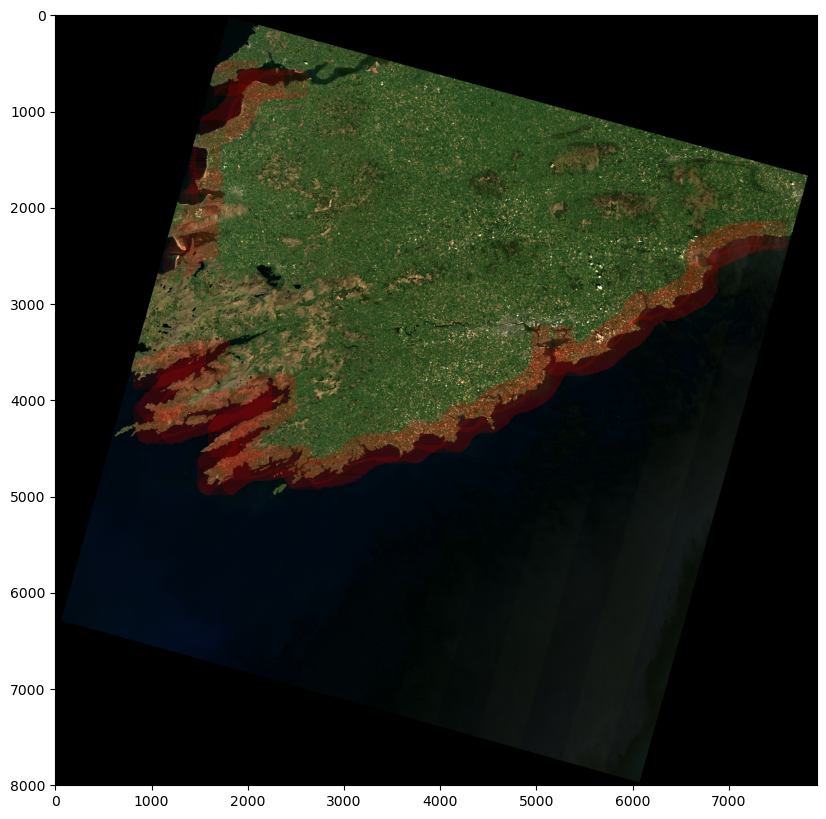

In [127]:
# display all valid crops 
tile = '207_24'
id = tile_ids[tile][0]
RGB = utils.get_rgb(id)
geo = utils.get_geolocation(id)


for utmx,utmy in valid_crops[tile]:
    y,x = geo.index(utmx,utmy)
    RGB = cv2.rectangle(RGB,(x,y),(x+256,y+256),(255,0,0),1)

plt.figure(figsize=(10,10))
plt.imshow(RGB)

1550 2730


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2690 1130


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2320 1450


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5550 1400


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2160 3450


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


890 5300


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


6040 2880


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3980 3050


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3940 2360


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1700 5560


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5010 1510


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


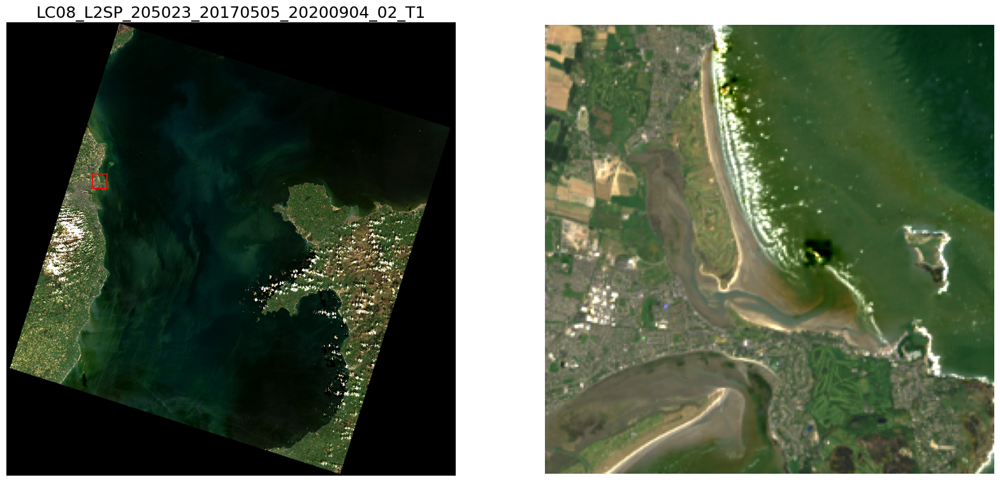

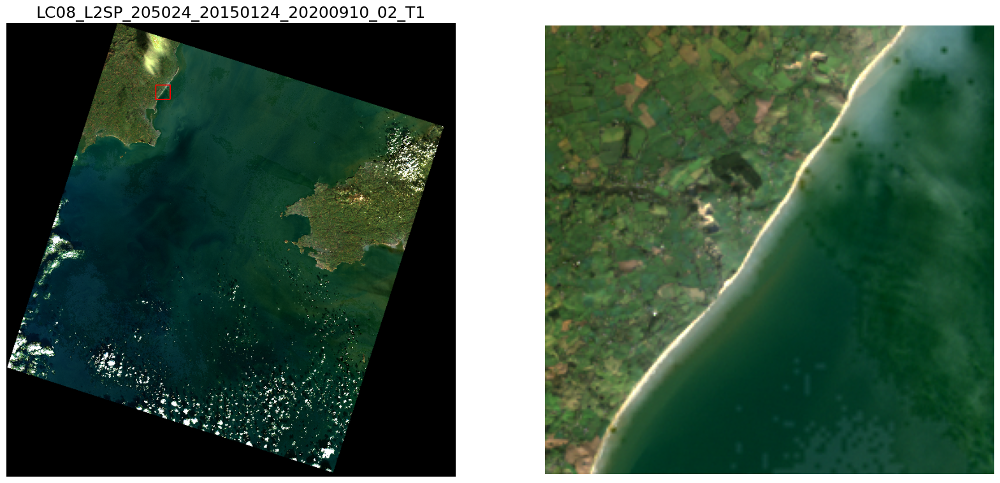

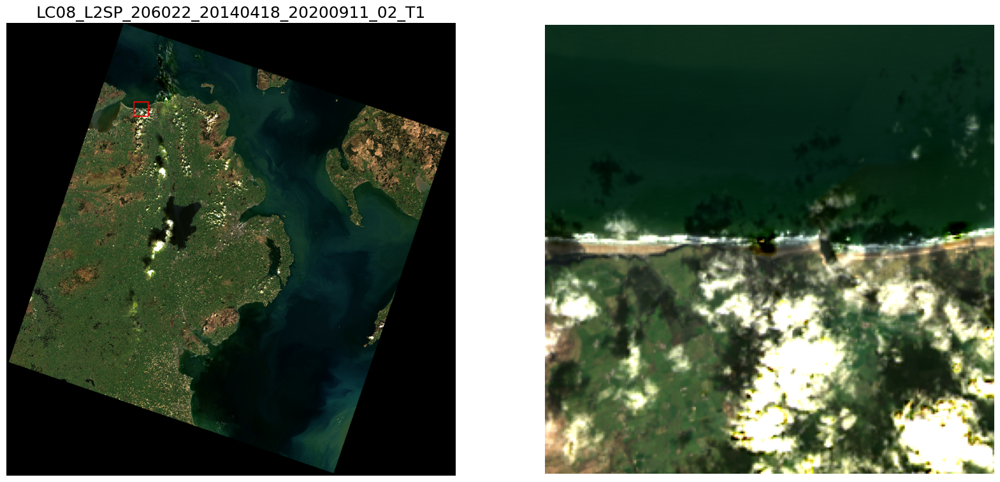

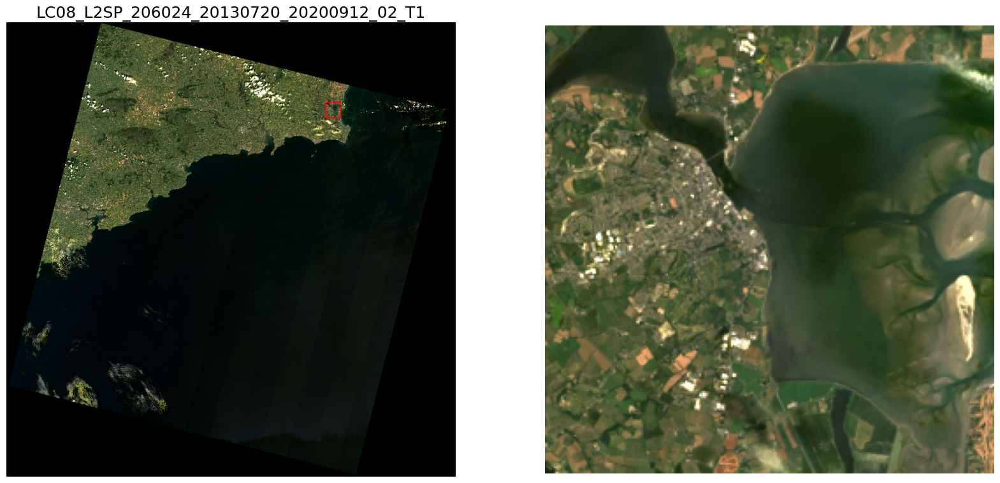

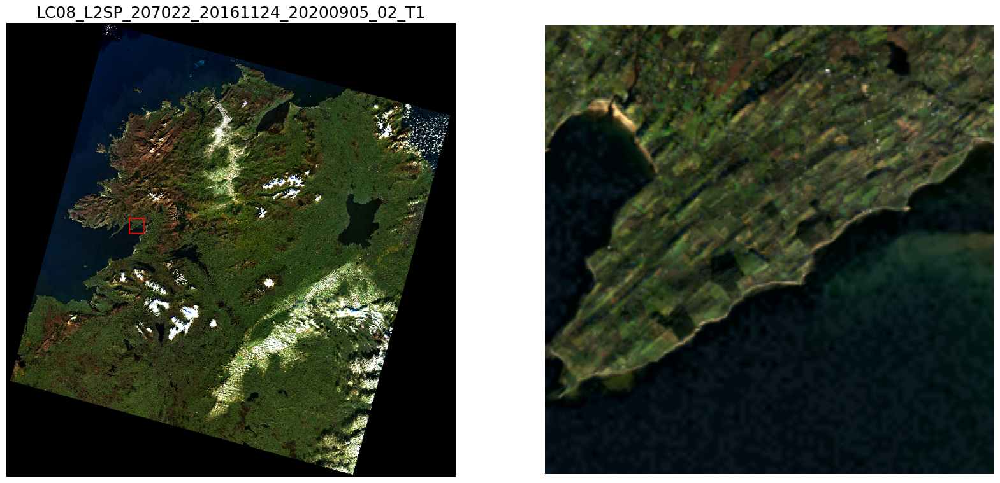

...

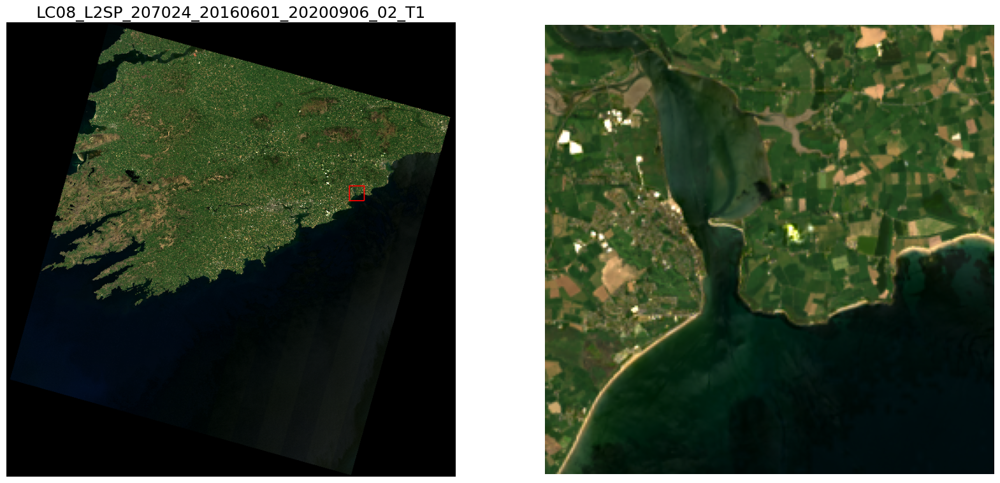

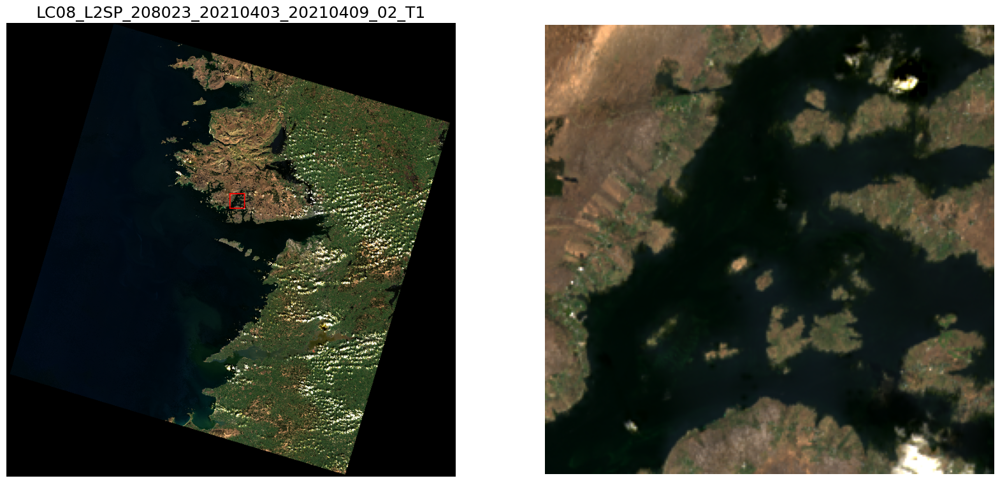

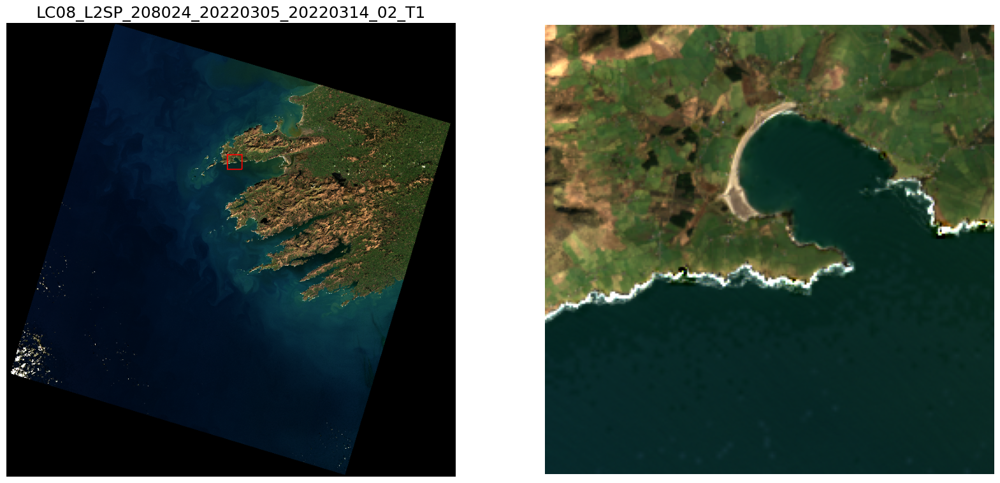

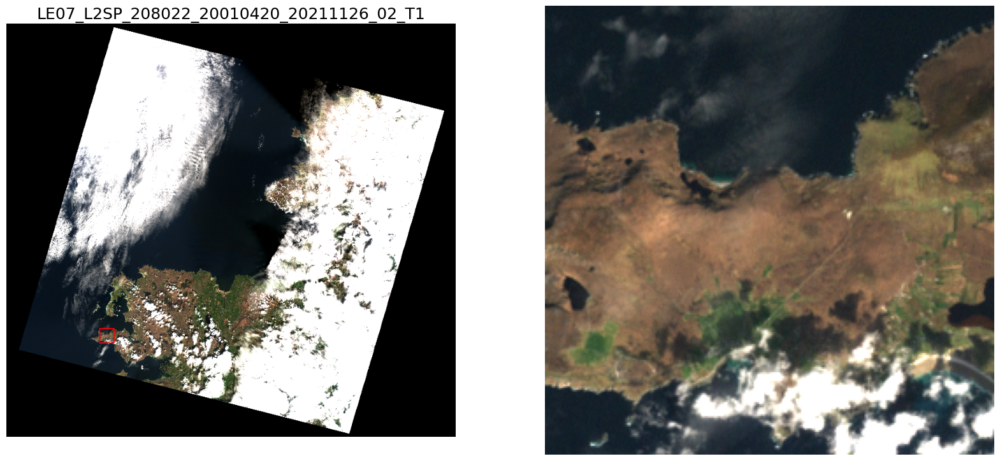

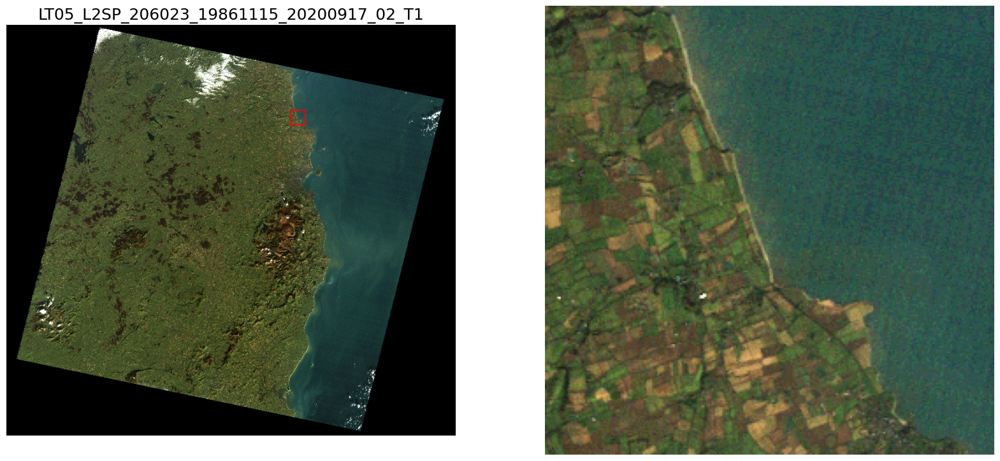

In [69]:
valid_crops = json.load(open(base_path + 'valid_test_crops.json'))

final_crop = {}

for tile in tiles:
    
    id = tile_ids[tile][0]
    geo = utils.get_geolocation(id)

    # get random crop from list of valid crops
    utmx,utmy = random.choice(valid_crops[tile])
    final_crop[tile] = (utmx,utmy)

    # display crop
    y,x = geo.index(utmx,utmy)
    print(x,y)
    display_crop(id,x,y)

# save final crops as json
with open(base_path + 'final_test_crops.json', 'w') as fp:
    json.dump(final_crop, fp)

# Crop test images

In [6]:
final_crop = json.load(open(base_path + 'final_test_crops.json'))

# Create test set from final crops
for tile in tiles:
    utmx,utmy = final_crop[tile]

    ids = tile_ids[tile]
    for id in ids:
        geo = utils.get_geolocation(id)
        y,x = geo.index(utmx,utmy)

        stack = utils.get_stack(id)
        stack_crop = stack[y:y+256,x:x+256,:]

        # save crop
        np.save(base_path + 'test/' + id + '.npy',stack_crop)

        # save RGB to annotate
        """rgb = utils.rgb_from_stack(stack_crop,True)
        rgb = Image.fromarray((rgb*255).astype(np.uint8))
        rgb.save(base_path + 'test to label/' + id + '.png')"""

In [16]:
QA = test[:,:,7]

cloud_mask = 1- np.vectorize(utils.get_mask)(QA,type='cloud')
shadow_mask = 1- np.vectorize(utils.get_mask)(QA,type='shadow')

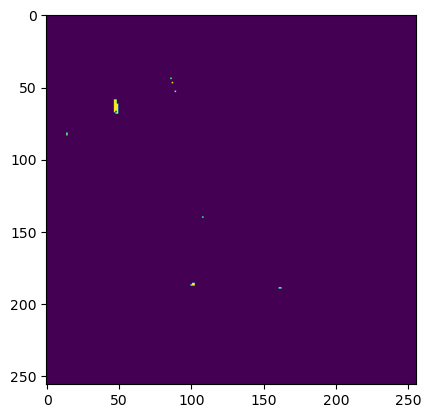

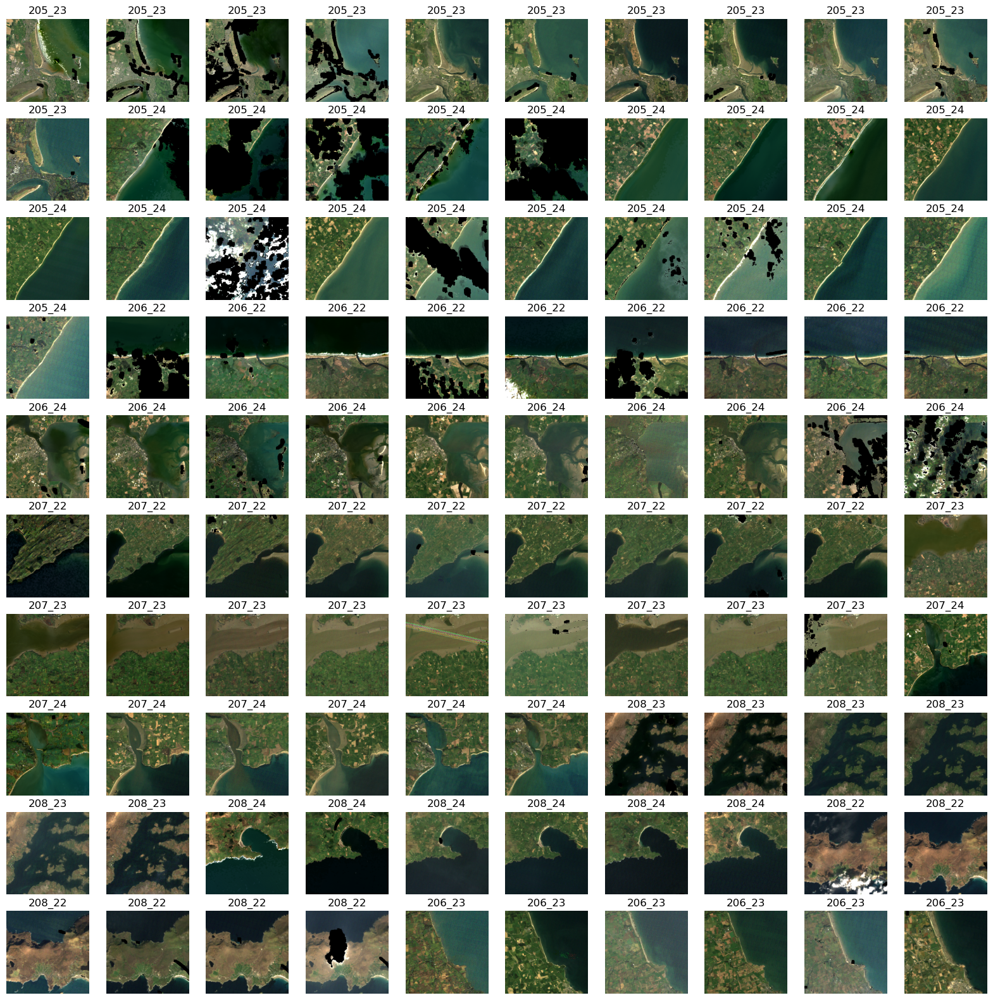

In [20]:
# Display test set
fig,ax = plt.subplots(10,10,figsize=(20,20))

i = 0
for tile in tiles:
    for id in tile_ids[tile]:

        test = np.load(base_path + 'test/' + id + '.npy')
        rgb = utils.rgb_from_stack(test)

        QA = test[:,:,7]

        cloud_mask = np.vectorize(utils.get_mask)(QA,type='cloud')
        shadow_mask = np.vectorize(utils.get_mask)(QA,type='shadow')

        rgb = rgb*cloud_mask[:,:,None]*shadow_mask[:,:,None]
        
        ax[i//10,i%10].imshow(rgb)
        ax[i//10,i%10].axis('off')

        tile = df_labels[df_labels['id'] == id]['tile'].values[0]

        #set title
        ax[i//10,i%10].set_title(tile,fontsize=12)

        i += 1

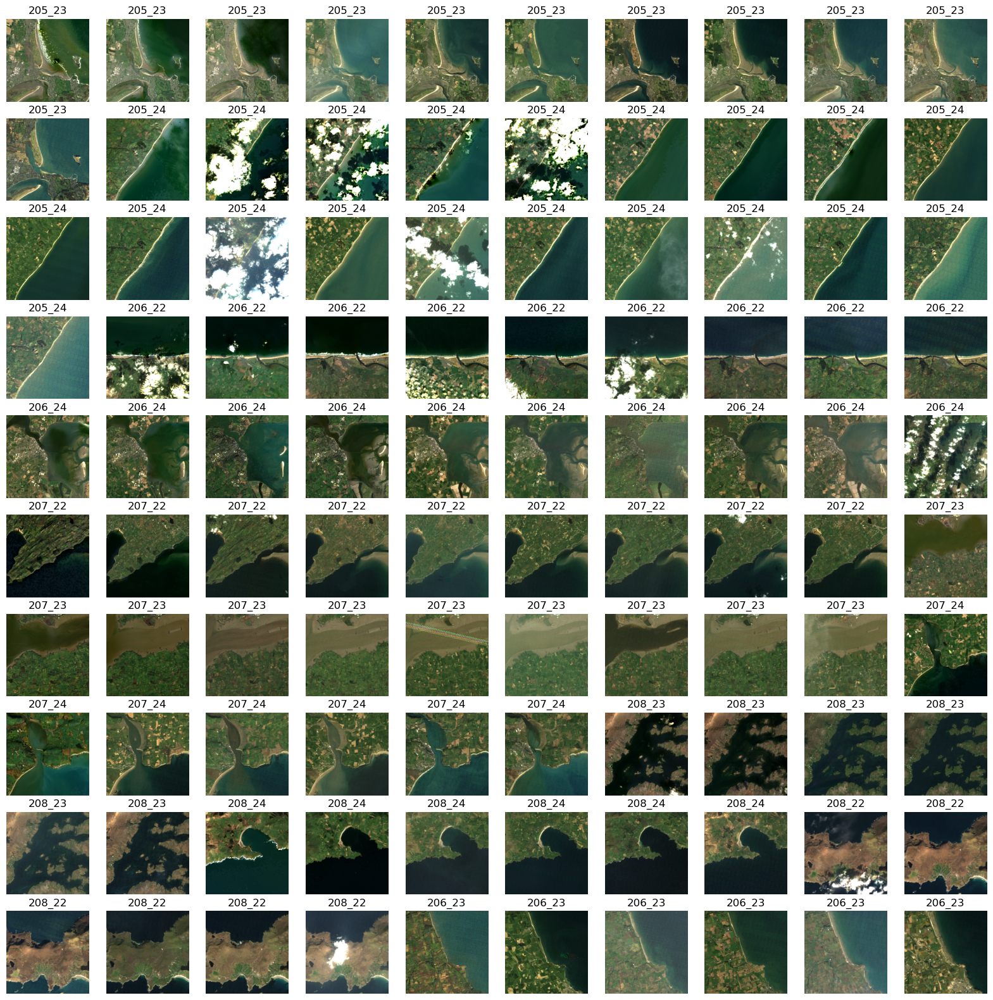

In [134]:
# Display test set
fig,ax = plt.subplots(10,10,figsize=(20,20))

i = 0
for tile in tiles:
    for id in tile_ids[tile]:

        test = np.load(base_path + 'test/' + id + '.npy')
        rgb = utils.rgb_from_stack(test)
        
        ax[i//10,i%10].imshow(rgb)
        ax[i//10,i%10].axis('off')

        tile = df_labels[df_labels['id'] == id]['tile'].values[0]

        #set title
        ax[i//10,i%10].set_title(tile,fontsize=12)

        i += 1

# Get training images

In [13]:
final_crop = json.load(open(base_path + 'final_test_crops.json'))
final_crop

{'205_23': [289800.0, 5925600.0],
 '205_24': [270900.0, 5818800.0],
 '206_22': [255000.0, 6123900.0],
 '206_24': [670200.0, 5804400.0],
 '207_22': [545100.0, 6057000.0],
 '207_23': [501000.0, 5838000.0],
 '207_24': [576900.0, 5760000.0],
 '208_23': [450600.0, 5913300.0],
 '208_24': [402600.0, 5778000.0],
 '208_22': [422700.0, 5987100.0],
 '206_23': [680400.0, 5951100.0]}

In [31]:
def check_train_crop(tile, mask,QA,geo,x,y,size=256,check_coast=False):

    """check if a training crop is valid based on: 
     - missing data
     - geolocation of test image"""
    
    # check if crop is in testing location
    utmx,utmy = final_crop[tile]
    testy,testx = geo.index(utmx,utmy)
    R1 = [x,y,x+size,y+size]
    R2 = [testx,testy,testx+size,testy+size]
    if (R1[0]>=R2[2]) or (R1[2]<=R2[0]) or (R1[3]<=R2[1]) or (R1[1]>=R2[3]):
        pass
    else:
        return False
    
    # check if there is missing data
    QA_crop = QA[y:y+size,x:x+size]
    miss_data = np.sum(QA_crop == 1)
    if miss_data > 0:
        return False
    
    # check if between 40 and 60% of the crop is water
    if check_coast:
        mask_crop = mask[y:y+size,x:x+size]
        per_water = np.sum(mask_crop) / (size*size)
        if per_water < 0.4 or per_water > 0.6:
            return False

    return True

In [28]:
#crop a random 256x256 image from each scene
def random_crop(tile, mask,QA,geo, size=256,check_coast=False):
    """Get crop with random location"""

    # get image dimensions
    y,x = mask.shape

    # get random location
    valid_crop = False
    while not valid_crop:
        x0 = np.random.randint(0,x-size)
        y0 = np.random.randint(0,y-size)

        valid_crop = check_train_crop(tile,mask,QA,geo,x0,y0,size=size,check_coast=check_coast)
    
    return x0,y0
    

In [37]:
def crop_sense_check(i):

    """Display a random crop from a given scene"""
    row = df_labels.iloc[i]

    id = row['id']
    tile = row['tile']
    print(id,tile)

    stack = utils.get_stack(id)
    mask = utils.get_mask(id)
    QA = utils.get_QA(id)
    geo = utils.get_geolocation(id)

    # add test location
    rgb = utils.get_rgb(id)
    utmx,utmy = final_crop[tile]
    testy,testx = geo.index(utmx,utmy)
    rgb = cv2.rectangle(rgb,(testx,testy),(testx+256,testy+256),(255,0,0),10)

    # add 300 random crops
    for i in range(300):
        x0,y0 = random_crop(tile,mask,QA,geo)
        rgb = cv2.rectangle(rgb,(x0,y0),(x0+256,y0+256),(0,0,255),10)

    # get 2 fine tune training crops
    """for i in range(2):
        x0,y0 = random_crop(tile,mask,QA,geo,check_coast=True)
        rgb = cv2.rectangle(rgb,(x0,y0),(x0+256,y0+256),(0,255,0),10)"""


    fig = plt.figure(figsize=(10,10))
    plt.imshow(rgb)
    plt.xticks([])
    plt.yticks([])


    return fig

LC08_L2SP_205023_20170505_20200904_02_T1 205_23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


LC08_L2SP_205024_20230420_20230429_02_T1 205_24


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


LE07_L2SP_208022_20010420_20211126_02_T1 208_22


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


LT05_L2SP_207022_19890522_20200916_02_T1 207_22


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


LT05_L2SP_208023_20050306_20200902_02_T1 208_23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


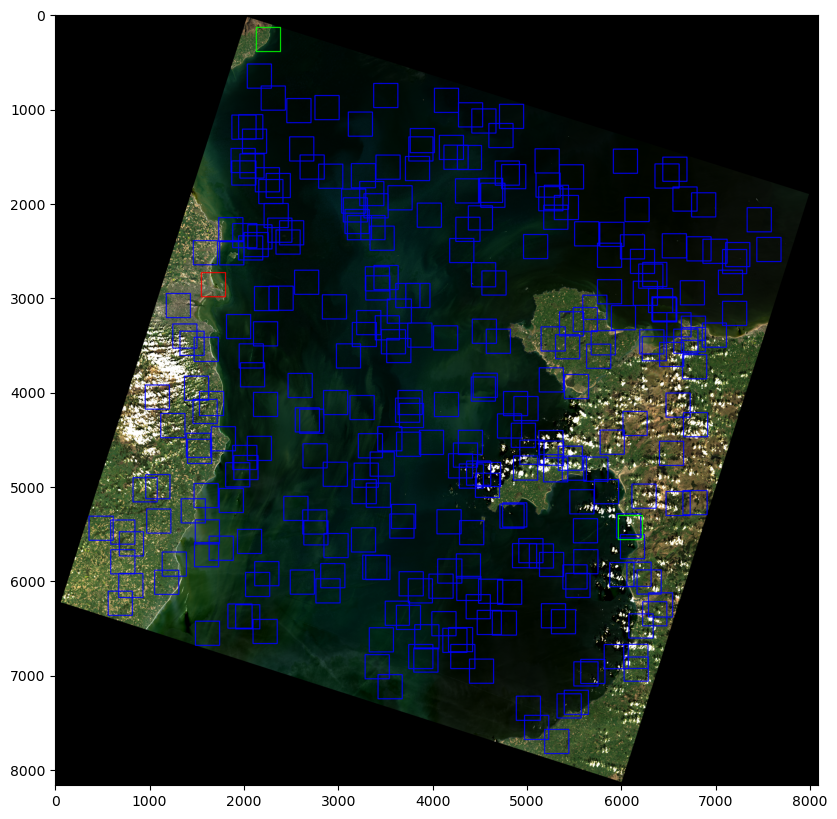

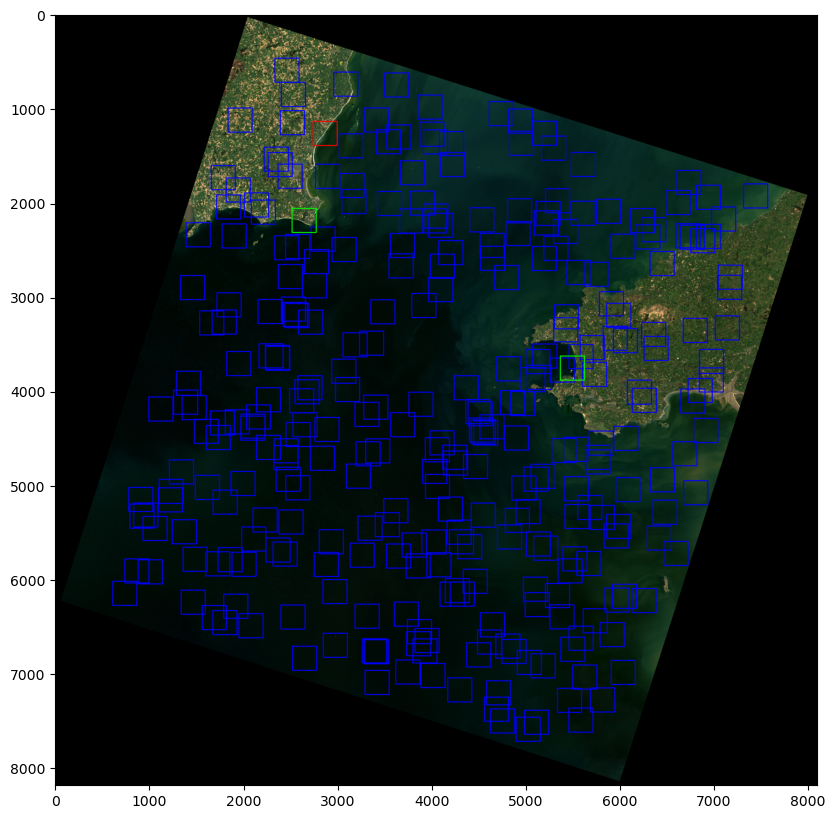

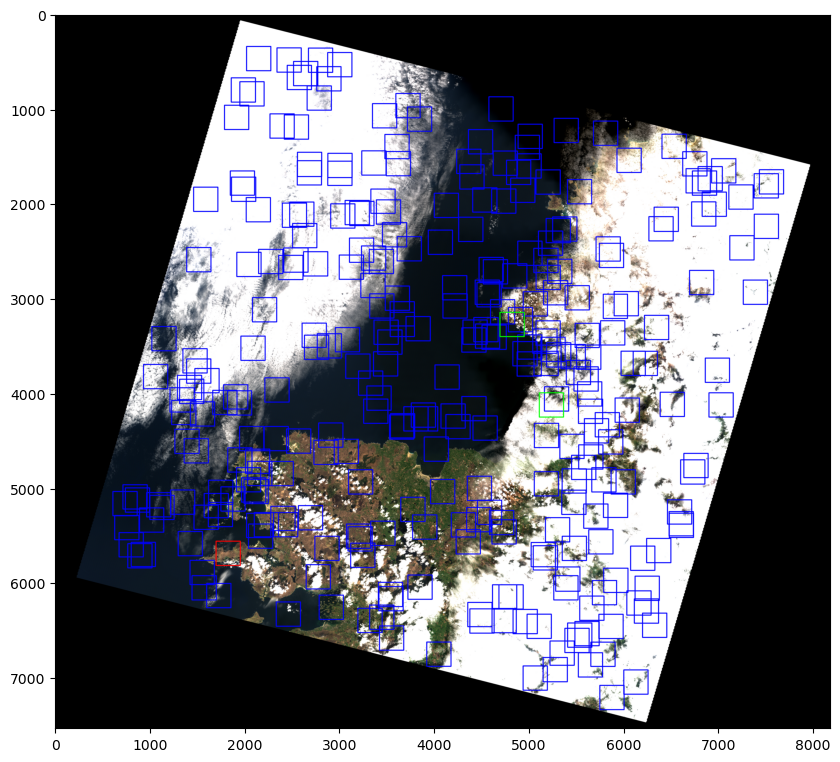

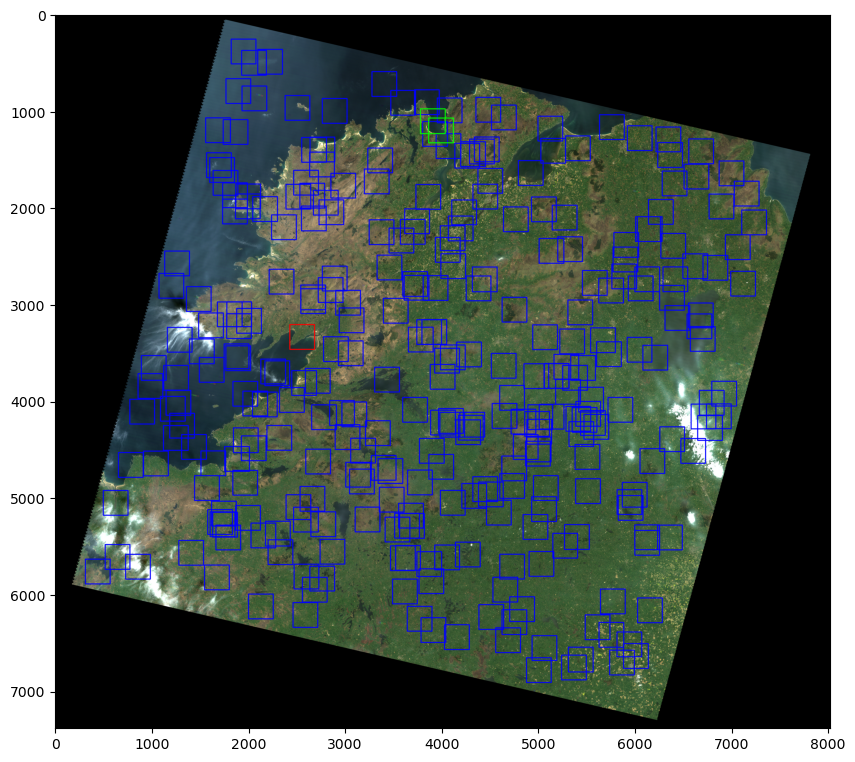

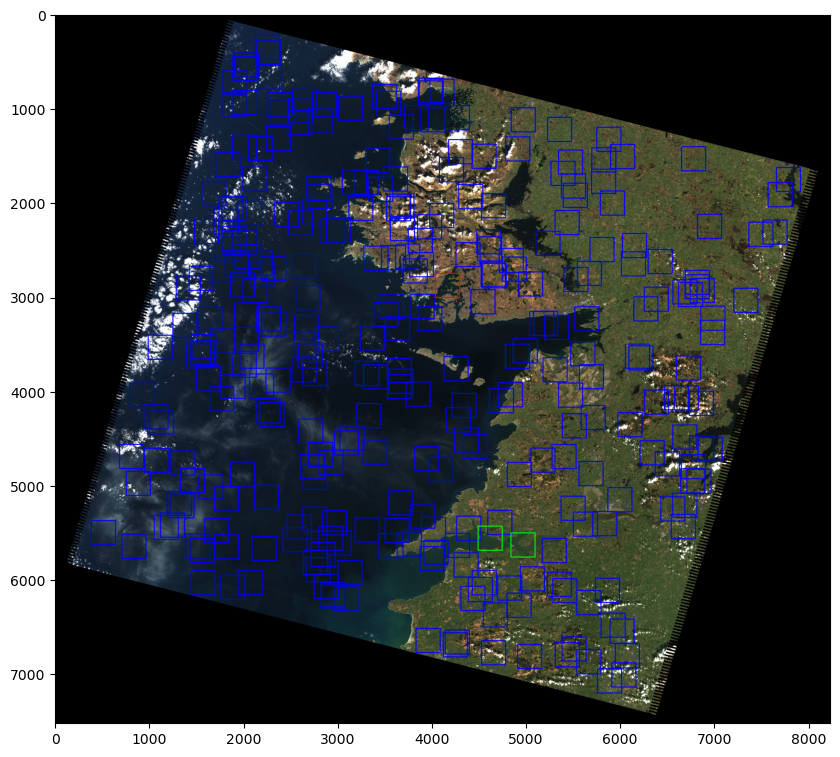

In [32]:
# sence check croping function
for i in [0,10,35,74,95]:
    crop_sense_check(i)

In [16]:
# sence check croping function
train_crop_details = {}
for i in range(100):
    row = df_labels.iloc[i]

    id = row['id']
    tile = row['tile']
    print(i,id)

    stack = utils.get_stack(id)
    mask = utils.get_mask(id)
    QA = utils.get_QA(id)
    geo = utils.get_geolocation(id)

    # add 300 random crops
    rough_crops = []
    hflip = []
    vflip = []
    for i in range(300):
        x0,y0 = random_crop(tile,mask,QA,geo)
        rough_crops.append([x0,y0])

        stack_crop = stack[y0:y0+256,x0:x0+256,:]

         # random flip
        if np.random.rand() > 0.5:
            stack_crop = np.flip(stack_crop, axis=0)
            hflip.append(1)
        else:
            hflip.append(0)
        if np.random.rand() > 0.5:
            stack_crop = np.flip(stack_crop, axis=1)
            vflip.append(1)
        else:
            vflip.append(0)

        # save crop
        np.save(base_path + 'training/' + id + '_' + str(i) + '.npy',stack_crop)

    # get 2 fine tune training crops
    finetune_crops = []
    for i in range(2):
        x0,y0 = random_crop(tile,mask,QA,geo,check_coast=True)
        finetune_crops.append([x0,y0])

        # save crop
        stack_crop = stack[y0:y0+256,x0:x0+256,:]
        np.save(base_path + 'finetune/' + id + '_' + str(i) + '.npy',stack_crop)

        # save rgb image to label
        rgb = utils.rgb_from_stack(stack_crop,True)
        rgb = Image.fromarray((rgb*255).astype(np.uint8))
        rgb.save(base_path + 'finetune to label/' + id + '_' + str(i)+ '.png')


    train_crop_details[id] = {'rough_crops':rough_crops,
                                'hflip':hflip,
                                'vflip':vflip,
                                'finetune_crops':finetune_crops}
    
# save details
with open(base_path + 'train_crop_details.json', 'w') as fp:
    json.dump(train_crop_details, fp)

0 LC08_L2SP_205023_20170505_20200904_02_T1
1 LC08_L2SP_205023_20190628_20200827_02_T1
2 LC08_L2SP_205023_20200529_20200820_02_T1
3 LC08_L2SP_205024_20150124_20200910_02_T1
4 LC08_L2SP_205024_20150719_20200909_02_T1
5 LC08_L2SP_205024_20160331_20200907_02_T1
6 LC08_L2SP_205024_20190204_20200829_02_T1
7 LC08_L2SP_205024_20190324_20200829_02_T1
8 LC08_L2SP_205024_20200411_20200822_02_T1
9 LC08_L2SP_205024_20210719_20210729_02_T1
10 LC08_L2SP_205024_20230420_20230429_02_T1
11 LC08_L2SP_206022_20140418_20200911_02_T1
12 LC08_L2SP_206022_20140723_20200911_02_T1
13 LC08_L2SP_206022_20170325_20200904_02_T1
14 LC08_L2SP_206022_20180702_20200831_02_T1
15 LC08_L2SP_206022_20230310_20230320_02_T1
16 LC08_L2SP_206024_20130720_20200912_02_T1
17 LC08_L2SP_206024_20150421_20200909_02_T1
18 LC08_L2SP_206024_20170120_20200905_02_T1
19 LC08_L2SP_206024_20181022_20200830_02_T1
20 LC08_L2SP_207022_20161124_20200905_02_T1
21 LC08_L2SP_207022_20170503_20200904_02_T1
22 LC08_L2SP_207023_20130403_20200913_02_T

LC08_L2SP_205023_20190628_20200827_02_T1 205_23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


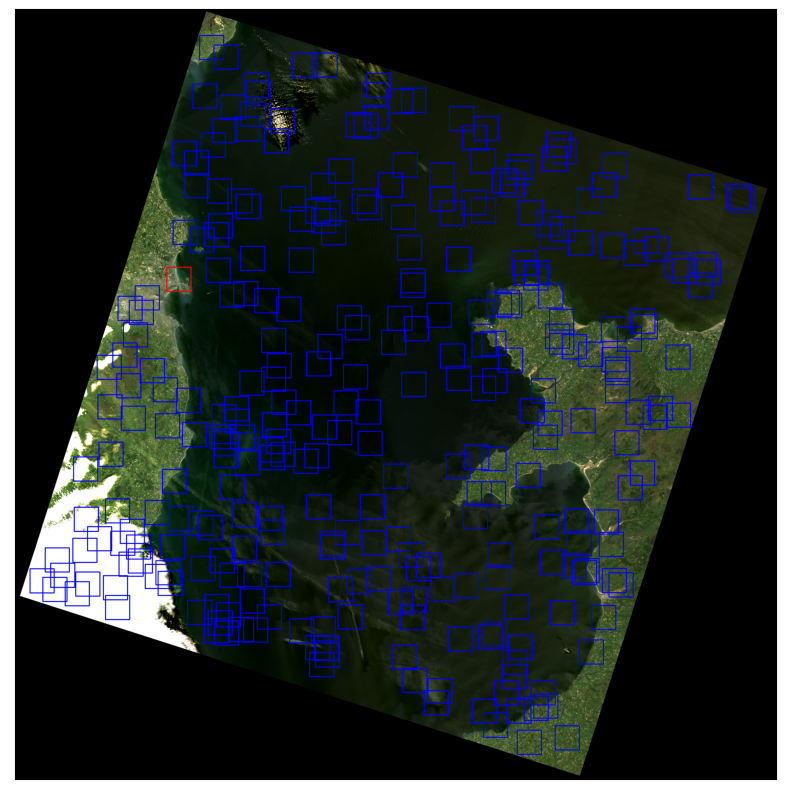

In [42]:
fig = crop_sense_check(1)
utils.save_fig(fig,'crop_sense_check')

In [185]:
id = list(train_crop_details.keys())[95]
print(len(train_crop_details.keys()))
print(len(train_crop_details[id]['rough_crops']))
print(np.mean(train_crop_details[id]['hflip']))
print(np.mean(train_crop_details[id]['vflip']))
print(len(train_crop_details[id]['finetune_crops']))

100
300
0.46
0.5333333333333333
2


# Append test annotations to stack
<br>
These test annotations where created using label studio with help from the 3_label_studio.ipynb file

In [22]:
mask_paths  = "../data/rough test masks/" #UPDATE
paths = glob.glob(mask_paths + "*")
paths.sort()

In [23]:
for i,id in enumerate(df_labels["id"]):

    test = np.load(base_path + 'test/' + id + '.npy')
    test = test[:,:,[0,1,2,3,4,5,6,7,8]]

    mask = np.load(paths[i])
    mask = np.round(mask/255.0)
    mask = 1-mask.astype(np.uint8)
    edge = utils.edge_from_mask(mask)


    mask = np.expand_dims(mask,axis=2)
    edge = np.expand_dims(edge,axis=2)

    test = np.concatenate([test,mask,edge],axis=2)

    # save npy
    np.save(base_path + 'test/' + id + '.npy',test)

# archive

In [ ]:
def random_test_crop(mask,RGB,size=256):
    """Randomly crop a 256x256 patch with given constraints"""

    invalid = True
    while invalid:
        # Get random x,y coordinates
        x = np.random.randint(0,mask.shape[0]-size)
        y = np.random.randint(0,mask.shape[1]-size)

        mask_crop = mask[x:x+size,y:y+size]
        rgb_crop = RGB[x:x+size,y:y+size]
        
        # check if percentage of water is between 40% and 60%
        per_water = np.sum(mask_crop) / (size*size)
        miss_data = np.sum(rgb_crop == [0,0,0])

        invalid = per_water < 0.4 or per_water > 0.6 or miss_data > 0
         
    return x,y